In [96]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.cbook as cbook
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


In [2]:
cluster =  [19637,
            23299,
            71673,
            92845,
            109587,
            110250,
            143597,
            197327,
            209579,
            229331,
            278451,
            279706,
            316410,
            316447,
            318872,
            319975,
            378922,
            427531,
            427880,
            455908,
            489482,
            489854,
            533395,
            543360]

In [3]:
test = 'test'+ str(3)
test

'test3'

In [4]:
def get_bldg_df(bldg_id: int, upgrade_package:int) -> pd.DataFrame:
    """
    Returns a dataframe with the relevant heating and cooling data for a given building
    """
    if upgrade_package in [0,1,2]:
        columns = ['timestamp', 
                    'out.natural_gas.heating.energy_consumption',
                    'out.electricity.heating_fans_pumps.energy_consumption',
                    'out.electricity.cooling.energy_consumption',
                    'out.electricity.cooling_fans_pumps.energy_consumption']
    elif upgrade_package in [3,4]:
        columns = ['timestamp', 
                    'out.electricity.heating.energy_consumption',
                    'out.electricity.heating_fans_pumps.energy_consumption',
                    'out.electricity.heating_hp_bkup.energy_consumption',
                    'out.electricity.cooling.energy_consumption',
                    'out.electricity.cooling_fans_pumps.energy_consumption']
    elif upgrade_package == 5:
        columns = ['timestamp',
                    'out.natural_gas.heating_hp_bkup.energy_consumption',
                    'out.electricity.heating.energy_consumption',
                    'out.electricity.heating_fans_pumps.energy_consumption',
                    'out.electricity.cooling.energy_consumption',
                    'out.electricity.cooling_fans_pumps.energy_consumption']
    else:
        print('upgrade_package must be an integer between 0 and 5 (inclusive)')
        return

                    
    file_name = str(bldg_id) + '-' + str(upgrade_package) + '.parquet'
    file_path = os.path.join('NREL_ResStock','custom_bundle_01','upgrade_' + str(upgrade_package), file_name)

    df = pd.read_parquet(file_path, columns=columns)
    df.index.name = None
    df.reset_index(inplace=True, drop=True)
    df['timestamp'] = pd.to_datetime(df['timestamp'])
    ## subtract 15 minutes from timestamps to align with grid data, each timestamp represents the beginning of the interval
    df['timestamp'] = df['timestamp'] - pd.Timedelta(minutes=15)
    df.set_index('timestamp', inplace=True)
    df_hourly = df.resample('H').sum()

    # if upgrade_package is = 4 then add a column to correct for heat pump backup electric
    # correct for the fact that the upgrade has a heat pump backup electric that kicks in at 41 degrees, not really representative of a typical efficient heat pump today
    if upgrade_package in [3,4]:
        df_hourly['out.electricity.heating.energy_consumption_corrected'] = df_hourly['out.electricity.heating.energy_consumption'] + (0.4 * df_hourly['out.electricity.heating_hp_bkup.energy_consumption'])
        df_hourly['electricity_total_heating'] = df_hourly['out.electricity.heating.energy_consumption_corrected'] + df_hourly['out.electricity.heating_fans_pumps.energy_consumption']
    elif upgrade_package == 5:
        df_hourly['electricity_total_heating'] = df_hourly['out.electricity.heating.energy_consumption'] + df_hourly['out.electricity.heating_fans_pumps.energy_consumption']
        df_hourly['natgas_total_heating'] = df_hourly['out.natural_gas.heating.energy_consumption']
    else:
        df_hourly['electricity_total_heating'] = df_hourly['out.electricity.heating_fans_pumps.energy_consumption']
        df_hourly['natgas_total_heating'] = df_hourly['out.natural_gas.heating.energy_consumption']

    df_hourly['electricity_total_cooling'] = df_hourly['out.electricity.cooling.energy_consumption'] + df_hourly['out.electricity.cooling_fans_pumps.energy_consumption']

    df_hourly['electricity_HVAC'] = df_hourly['electricity_total_heating'] + df_hourly['electricity_total_cooling']

    # add columns for total electricity and emissions due to heating and cooling for each fuel type?
    # TODO
    
    return df_hourly

In [5]:
df = get_bldg_df(19637, 0)

In [6]:
df.head()

,out.natural_gas.heating.energy_consumption,out.electricity.heating_fans_pumps.energy_consumption,out.electricity.cooling.energy_consumption,out.electricity.cooling_fans_pumps.energy_consumption,electricity_total_heating,natgas_total_heating,electricity_total_cooling,electricity_HVAC
timestamp,,,,,,,,
2007-01-01 00:00:00,4.309903,0.108,0.04,0.0,0.108,4.309903,0.04,0.148
2007-01-01 01:00:00,0.385388,0.009,0.04,0.0,0.009,0.385388,0.04,0.049
2007-01-01 02:00:00,0.913503,0.022,0.04,0.0,0.022,0.913503,0.04,0.062
2007-01-01 03:00:00,1.473561,0.038,0.04,0.0,0.038,1.473561,0.04,0.078
2007-01-01 04:00:00,1.944527,0.048,0.04,0.0,0.048,1.944527,0.04,0.088


In [7]:
temperature_data_file = os.path.join('weather_files','USA_MA_Beverly.Muni.AP.725088_TMY3','typical_weather_temperature.csv')

In [8]:
weather_df = pd.read_csv(temperature_data_file)

In [9]:
weather_df

,temp
0,4.0
1,4.0
2,4.0
3,3.0
4,3.0
...,...
8755,-4.0
8756,-4.0
8757,-4.0
8758,-4.0


In [10]:
# create a dictionary of dataframes for each building
cluster_baseline_dfs = {}

for upgrade in [0]:
    for bldg in cluster:
        dict_key = str(bldg) + '-' + str(upgrade)
        cluster_baseline_dfs[dict_key] = get_bldg_df(bldg, upgrade)


cluster_upgrade_dfs = {}

for upgrade in [4]:
    for bldg in cluster:
        dict_key = str(bldg) + '-' + str(upgrade)
        cluster_upgrade_dfs[dict_key] = get_bldg_df(bldg, upgrade)


In [38]:
# create a dataframe with the total electricity consumption for each building in the cluster
cluster_baseline_heat_electricity = pd.DataFrame()
cluster_baseline_cool_electricity = pd.DataFrame()
cluster_baseline_hvac_electricity = pd.DataFrame()
cluster_baseline_natgas = pd.DataFrame()

for key in cluster_baseline_dfs.keys():
    cluster_baseline_heat_electricity[key] = cluster_baseline_dfs[key]['electricity_total_heating']
    cluster_baseline_cool_electricity[key] = cluster_baseline_dfs[key]['electricity_total_cooling']
    cluster_baseline_hvac_electricity[key] = cluster_baseline_dfs[key]['electricity_HVAC']
    cluster_baseline_natgas[key] = cluster_baseline_dfs[key]['natgas_total_heating']

cluster_baseline_heat_electricity_hrly_sum = cluster_baseline_heat_electricity.sum(axis=1)
cluster_baseline_heat_electricity_hrly_mean = cluster_baseline_heat_electricity.mean(axis=1)

cluster_baseline_cool_electricity_hrly_sum = cluster_baseline_cool_electricity.sum(axis=1)
cluster_baseline_cool_electricity_hrly_mean = cluster_baseline_cool_electricity.mean(axis=1)

cluster_baseline_hvac_electricity_hrly_sum = cluster_baseline_hvac_electricity.sum(axis=1)
cluster_baseline_hvac_electricity_hrly_mean = cluster_baseline_hvac_electricity.mean(axis=1)

cluster_baseline_natgas_hrly_sum = cluster_baseline_natgas.sum(axis=1)
cluster_baseline_natgas_hrly_mean = cluster_baseline_natgas.mean(axis=1)

In [37]:
# create a dataframe with the total electricity consumption for each building in the cluster after upgrade
cluster_upgrade_heat_electricity = pd.DataFrame()
cluster_upgrade_cool_electricity = pd.DataFrame()
cluster_upgrade_hvac_electricity = pd.DataFrame()

for key in cluster_upgrade_dfs.keys():
    cluster_upgrade_heat_electricity[key] = cluster_upgrade_dfs[key]['electricity_total_heating']
    cluster_upgrade_cool_electricity[key] = cluster_upgrade_dfs[key]['electricity_total_cooling']
    cluster_upgrade_hvac_electricity[key] = cluster_upgrade_dfs[key]['electricity_HVAC']

cluster_upgrade_heat_electricity_hrly_sum = cluster_upgrade_heat_electricity.sum(axis=1)
cluster_upgrade_heat_electricity_hrly_mean = cluster_upgrade_heat_electricity.mean(axis=1)

cluster_upgrade_cool_electricity_hrly_sum = cluster_upgrade_cool_electricity.sum(axis=1)
cluster_upgrade_cool_electricity_hrly_mean = cluster_upgrade_cool_electricity.mean(axis=1)

cluster_upgrade_hvac_electricity_hrly_sum = cluster_upgrade_hvac_electricity.sum(axis=1)
cluster_upgrade_hvac_electricity_hrly_mean = cluster_upgrade_hvac_electricity.mean(axis=1)

In [39]:
cluster_baseline_hvac_electricity.head()

,19637-0,23299-0,71673-0,92845-0,109587-0,110250-0,143597-0,197327-0,209579-0,229331-0,...,318872-0,319975-0,378922-0,427531-0,427880-0,455908-0,489482-0,489854-0,533395-0,543360-0
timestamp,,,,,,,,,,,,,,,,,,,,,
2007-01-01 00:00:00,0.148,0.120,0.136,0.063,0.127,0.305,0.153,0.114,0.142,0.157,...,0.145,0.189,0.162,0.259,0.114,0.104,0.097,0.163,0.189,0.056
2007-01-01 01:00:00,0.049,0.113,0.144,0.068,0.116,0.269,0.151,0.120,0.138,0.150,...,0.146,0.181,0.152,0.238,0.124,0.092,0.107,0.151,0.173,0.065
2007-01-01 02:00:00,0.062,0.126,0.135,0.074,0.112,0.252,0.151,0.125,0.151,0.147,...,0.144,0.132,0.152,0.229,0.129,0.092,0.209,0.144,0.172,0.069
2007-01-01 03:00:00,0.078,0.117,0.139,0.082,0.117,0.048,0.154,0.133,0.092,0.148,...,0.129,0.146,0.185,0.230,0.137,0.098,0.182,0.148,0.179,0.076
2007-01-01 04:00:00,0.088,0.115,0.144,0.089,0.123,0.064,0.160,0.141,0.104,0.150,...,0.135,0.155,0.164,0.233,0.146,0.103,0.173,0.159,0.186,0.084


In [40]:
cluster_baseline_hvac_electricity.sum().mean()

1889.2669583333336

In [41]:
cluster_baseline_hvac_electricity_hrly_mean.sum()

1889.2669583333336

In [42]:
cluster_upgrade_hvac_electricity.head()

,19637-4,23299-4,71673-4,92845-4,109587-4,110250-4,143597-4,197327-4,209579-4,229331-4,...,318872-4,319975-4,378922-4,427531-4,427880-4,455908-4,489482-4,489854-4,533395-4,543360-4
timestamp,,,,,,,,,,,,,,,,,,,,,
2007-01-01 00:00:00,0.771,1.411,0.9236,0.199,1.022,2.4922,1.165,1.405,0.927,0.822,...,1.190,1.185,1.084,1.760,0.452,0.752,0.513,1.105,1.070,0.273
2007-01-01 01:00:00,0.049,1.220,0.9310,0.223,0.869,1.8032,1.025,1.206,0.817,0.703,...,1.070,1.034,0.922,1.450,0.452,0.594,0.542,0.909,0.845,0.296
2007-01-01 02:00:00,0.132,1.314,0.7980,0.271,0.809,1.6000,0.954,1.134,0.914,0.653,...,0.994,0.570,0.906,1.336,0.456,0.578,1.664,0.808,0.800,0.317
2007-01-01 03:00:00,0.231,1.235,0.8570,0.345,0.863,0.0000,1.011,1.188,0.311,0.675,...,0.827,0.701,1.266,1.363,0.487,0.628,1.351,0.854,0.871,0.373
2007-01-01 04:00:00,0.297,1.233,0.9120,0.395,0.928,0.0980,1.076,1.252,0.408,0.702,...,0.916,0.789,0.994,1.404,0.534,0.682,1.271,0.993,0.940,0.424


In [43]:
# create a figure for plotting the baseline and upgrade electricity consumption for each building in the cluster
fig = go.Figure()

for key in cluster_baseline_heat_electricity.keys():
    fig.add_trace(go.Scatter(x=cluster_baseline_heat_electricity.index, y=cluster_baseline_heat_electricity[key],
                    mode='lines',
                    name=key,
                    line=dict(color='lightgray')))
    
for key in cluster_upgrade_heat_electricity.keys():
    fig.add_trace(go.Scatter(x=cluster_upgrade_heat_electricity.index, y=cluster_upgrade_heat_electricity[key],
                    mode='lines',
                    name=key,
                    line=dict(color='lightblue')))
    
fig.update_layout(title='Baseline and Upgrade Electricity Consumption for Each Building in the Cluster',
                    xaxis_title='Time',
                    yaxis_title='Electricity (kWh)',
                    legend_title='Building ID - Upgrade Package',
                    font=dict(
                        family="Courier New, monospace",
                        size=18
                    )
                )

fig.show()

In [69]:
# create the same plot except with just the upgrade cluster and only for january, february, march
# and make all the plots gray except for the mean, which should be purple and bold
fig = go.Figure()

# profiles for each bldg in cluster
for key in cluster_baseline_natgas.keys():
    fig.add_trace(go.Scatter(x=cluster_baseline_natgas.index, y=cluster_baseline_natgas[key],
                    mode='lines',
                    name=key,
                    line=dict(color='lightgray', width=0.5)))
    
# mean profile for cluster
fig.add_trace(go.Scatter(x=cluster_baseline_natgas.index, y=cluster_baseline_natgas_hrly_mean,
                    mode='lines',
                    name='mean',
                    line=dict(color='purple', width=2)))

# # add a second y axis for emissions
# fig.update_layout(yaxis2=dict(
#         title="Emissions (kgCO2)",
#         titlefont=dict(
#             color="purple"
#         ),
#         tickfont=dict(
#             color="purple"
#         ),
#         overlaying="y",
#         side="right"
#     ))

# # add a trace for emissions using the second y axis
# fig.add_trace(go.Scatter(x=cluster_baseline_natgas.index, y=cluster_baseline_natgas_hrly_mean * 0.18,
#                     mode='lines',
#                     name='emissions',
#                     line=dict(color='orange', width=2),
#                     fill='tozeroy',
#                     yaxis="y2"))

# make the background white
fig.update_layout(plot_bgcolor='white')
# make the grid lines light gray
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgray')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgray')
# make the plot border black
fig.update_layout(title='Baseline NatGas Consumption for Each Building in the Cluster',
    xaxis=dict(
        showline=True,
        showgrid=True,
        showticklabels=True,
        linecolor='black',
        linewidth=2,
        ticks='outside',
        tickfont=dict(
            family='Arial',
            size=12,
            color='black',
        ),
    ),
    yaxis=dict(
        showgrid=True,
        zeroline=True,
        showline=True,
        showticklabels=True,
    ),
    autosize=True,
    margin=dict(
        autoexpand=True,
        l=100,
        r=20,
        t=110,
    ),
    showlegend=False,
    plot_bgcolor='white'
)




# fig.update_layout(title='Baseline NatGas Consumption for Each Building in the Cluster',
#                     xaxis_title='Time',
#                     yaxis_title='Natural Gas (kWh)',
#                     legend_title='Building ID - Upgrade Package',
#                     font=dict(
#                         family="Courier New, monospace",
#                         size=10,
#                         color="RebeccaPurple"
#                     )
#                 )

fig.show()

In [21]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=cluster_baseline_natgas.index, y=cluster_baseline_natgas['mean_natgas_baseline'],
                    mode='lines',
                    name='mean_natgas_baseline',
                    line=dict(color='orange', width=2)))

fig.add_trace(go.Scatter(x=cluster_upgrade_electricity.index, y=cluster_upgrade_electricity['mean_electricity_upgrade'],
                    mode='lines',
                    name='mean_electricity_upgrade',
                    line=dict(color='blue', width=2)))

fig.add_trace(go.Scatter(x=cluster_upgrade_electricity.index, y=weather_df['temp'],
                         mode='lines',
                         name='temperature',
                         line=dict(color='red', width=1)))

fig.show()

In [22]:
# create the same plot except with just the upgrade cluster and only for january, february, march
# and make all the plots gray except for the mean, which should be purple and bold
fig = go.Figure()

for key in cluster_upgrade_electricity.keys():
    fig.add_trace(go.Scatter(x=cluster_upgrade_electricity.index, y=cluster_upgrade_electricity[key],
                    mode='lines',
                    name=key,
                    line=dict(color='lightgray')))
    
    
fig.add_trace(go.Scatter(x=cluster_upgrade_electricity.index, y=cluster_upgrade_electricity['mean_electricity_upgrade'],
                    mode='lines',
                    name='mean',
                    line=dict(color='purple', width=2)))

fig.update_layout(title='Upgrade Electricity Consumption for Each Building in the Cluster',
                    xaxis_title='Time',
                    yaxis_title='Electricity (kWh)',
                    legend_title='Building ID - Upgrade Package',
                    font=dict(
                        family="Courier New, monospace",
                        size=10,
                        color="RebeccaPurple"
                    )
                )

fig.show()

In [116]:
# create the same plotly graph but with only timestamps from january, february, and march
fig = go.Figure()

for key in cluster_upgrade_electricity.keys():
    fig.add_trace(go.Scatter(x=cluster_upgrade_electricity.loc['2007-01-20':'2007-01-27'].index, y=cluster_upgrade_electricity.loc['2007-01-20':'2007-01-27'][key],
                    mode='lines',
                    name=key,
                    line=dict(color='lightgray')))

fig.show()
# good_months = cluster_upgrade_electricity.loc['2019-01-01':'2019-03-31']

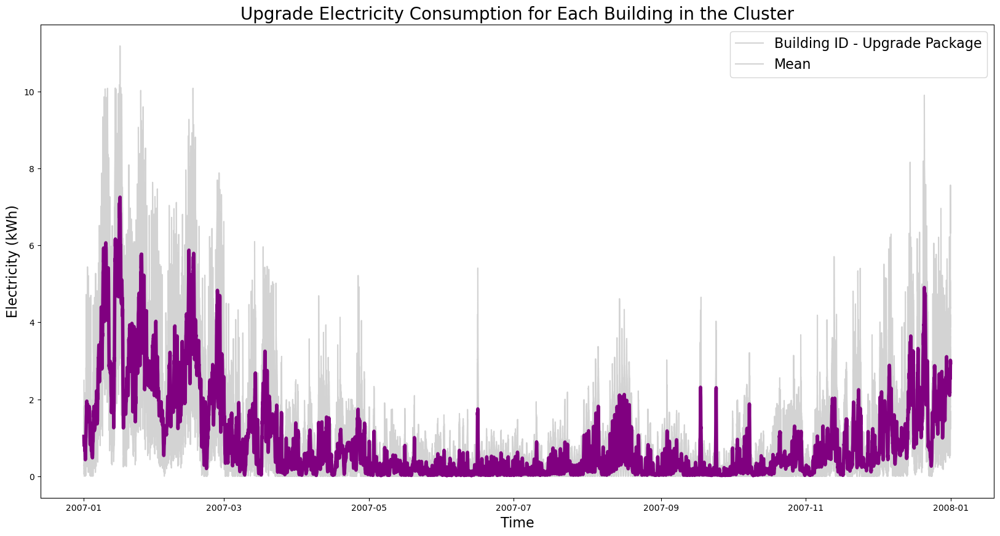

In [109]:
# create the same plot with matplotlib
fig, ax = plt.subplots(figsize=(20,10))

for key in cluster_upgrade_electricity.keys(): 
    ax.plot(cluster_upgrade_electricity[key], color='lightgray')

ax.plot(cluster_upgrade_electricity['mean_electricity_upgrade'], color='purple', linewidth=4)

ax.set_title('Upgrade Electricity Consumption for Each Building in the Cluster', fontsize=20)
ax.set_xlabel('Time', fontsize=16)

ax.set_ylabel('Electricity (kWh)', fontsize=16)

ax.legend(['Building ID - Upgrade Package', 'Mean'], fontsize=16)

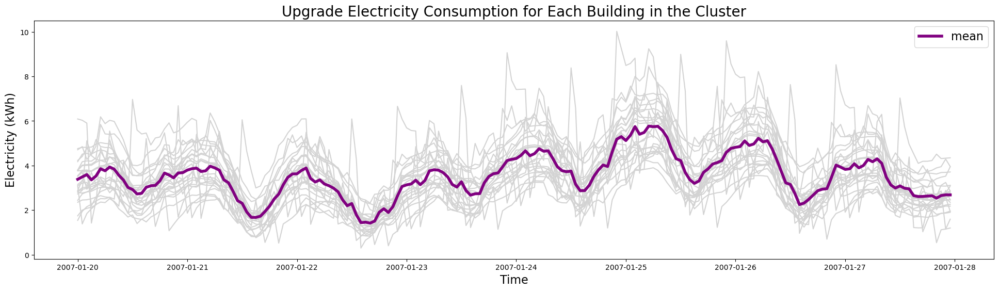

In [121]:
# create the same plot with matplotlib
fig, ax = plt.subplots(figsize=(24,6))

for key in cluster_upgrade_electricity.keys()[:-1]: 
    ax.plot(cluster_upgrade_electricity.loc['2007-01-20':'2007-01-27'][key], color='lightgray')

ax.plot(cluster_upgrade_electricity.loc['2007-01-20':'2007-01-27']['mean_electricity_upgrade'], color='purple', linewidth=4, label='mean')

ax.set_title('Upgrade Electricity Consumption for Each Building in the Cluster', fontsize=20)
ax.set_xlabel('Time', fontsize=16)

ax.set_ylabel('Electricity (kWh)', fontsize=16)

ax.legend(fontsize=16)

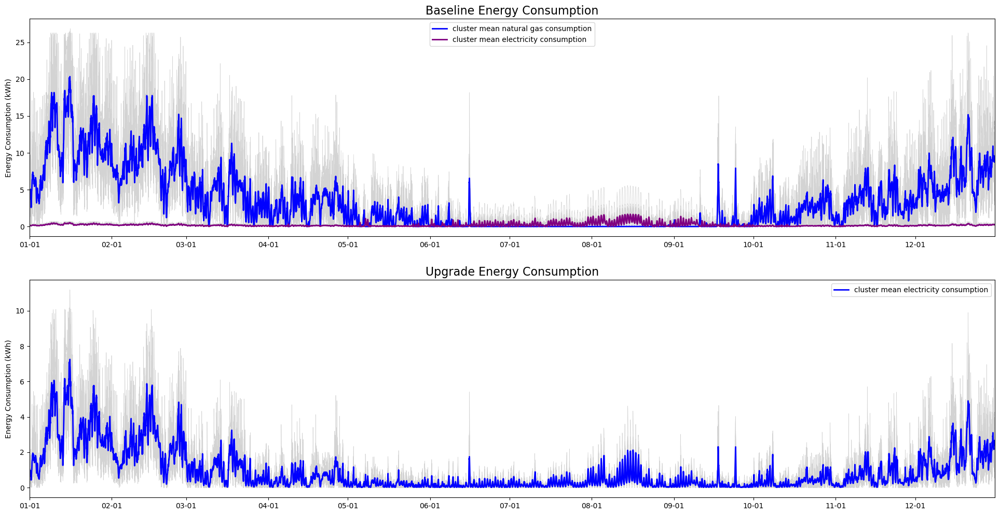

In [109]:
# create matplotlib subplots with 3 rows and 1 column
fig, ax = plt.subplots(2, 1, figsize=(24,12))
datemin = pd.Timestamp('2007-01-01')
datemax = pd.Timestamp('2007-12-31')

# plot the first row
for key in cluster_baseline_dfs.keys():
    ax[0].plot(cluster_baseline_natgas[key], color='lightgray', linewidth=0.5)
    ax[0].plot(cluster_baseline_hvac_electricity[key], color='lightgray', linewidth=0.5)

ax[0].plot(cluster_baseline_natgas_hrly_mean, color='blue', linewidth=2, label = 'cluster mean natural gas consumption')
ax[0].plot(cluster_baseline_hvac_electricity_hrly_mean, color='purple', linewidth=2, label = 'cluster mean electricity consumption')


# limit x axis to january
ax[0].set_xlim(datemin, datemax)
# change the x ticks to not include the year
ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))
ax[0].set_title('Baseline Energy Consumption', fontsize=16)
# ax[0].set_xlabel('Time', fontsize=10)
ax[0].set_ylabel('Energy Consumption (kWh)', fontsize=10)
ax[0].legend()


# plot the second row
for key in cluster_upgrade_dfs.keys():
    ax[1].plot(cluster_upgrade_hvac_electricity[key], color='lightgray', linewidth=0.5)

ax[1].plot(cluster_upgrade_hvac_electricity_hrly_mean, color='blue', linewidth=2, label = 'cluster mean electricity consumption')

# limit x axis to january
ax[1].set_xlim(datemin, datemax)
# change the x ticks to not include the year
ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))
ax[1].set_title('Upgrade Energy Consumption', fontsize=16)
# ax[0].set_xlabel('Time', fontsize=10)
ax[1].set_ylabel('Energy Consumption (kWh)', fontsize=10)
ax[1].legend()

In [110]:
NE_cambium_file = os.path.join('NREL_Cambium', 'Cambium22_LRMER_NewEngland.csv')
NE_LRME_df = pd.read_csv(NE_cambium_file)

In [111]:
NE_LRME_df

,mid-case,lowREcost,highREcost,95decarb2035,electrification
0,233.3,191.1,191.7,111.3,236.4
1,231.2,190.8,191.5,111.5,232.5
2,232.2,191.6,190.8,111.9,231.6
3,230.3,192.5,192.6,111.5,233.7
4,231.4,195.8,191.9,113.5,233.2
...,...,...,...,...,...
8755,268.3,248.6,233.3,133.7,271.3
8756,268.8,244.0,229.4,132.2,268.4
8757,267.1,244.9,229.1,131.8,265.2
8758,261.9,238.2,225.8,129.0,261.9


In [123]:
cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df['mid-case'].values/1000

timestamp
2007-01-01 00:00:00    0.034295
2007-01-01 01:00:00    0.031848
2007-01-01 02:00:00    0.032218
2007-01-01 03:00:00    0.030400
2007-01-01 04:00:00    0.031914
                         ...   
2007-12-31 19:00:00    0.066963
2007-12-31 20:00:00    0.065699
2007-12-31 21:00:00    0.070559
2007-12-31 22:00:00    0.072939
2007-12-31 23:00:00    0.069545
Freq: H, Length: 8760, dtype: float64

In [122]:
cluster_baseline_hvac_electricity_hrly_mean

timestamp
2007-01-01 00:00:00    0.147000
2007-01-01 01:00:00    0.137750
2007-01-01 02:00:00    0.138750
2007-01-01 03:00:00    0.132000
2007-01-01 04:00:00    0.137917
                         ...   
2007-12-31 19:00:00    0.249583
2007-12-31 20:00:00    0.244417
2007-12-31 21:00:00    0.264167
2007-12-31 22:00:00    0.278500
2007-12-31 23:00:00    0.273583
Freq: H, Length: 8760, dtype: float64

In [112]:
NE_LRME_df.sum()

mid-case           1797965.4
lowREcost          1502376.8
highREcost         1711393.2
95decarb2035        895062.7
electrification    1739238.7
dtype: float64

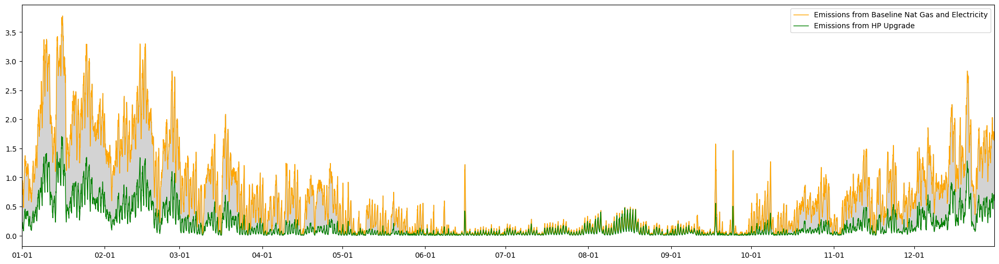

In [136]:
# plot emissions profiles for baseline and upgrade on the same axes
plt.figure(figsize=(24,6))
datemin = pd.Timestamp('2007-01-01')
datemax = pd.Timestamp('2007-12-31')
cambium_scenario = 'mid-case'

plt.plot(((cluster_baseline_natgas_hrly_mean * 0.18) + (cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000)), color='orange', linewidth=1, label = 'Emissions from Baseline Nat Gas and Electricity')
plt.plot((cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000), color='green', linewidth=1, label = 'Emissions from HP Upgrade')# limit x axis to datemin and datemax
plt.xlim(datemin, datemax)
# change the x ticks to not include the year
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))

# shade the area between the two lines
plt.fill_between(cluster_baseline_natgas_hrly_mean.index,
                    ((cluster_baseline_natgas_hrly_mean * 0.18) + (cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000)),
                    (cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000),
                    color='lightgray')
plt.savefig('test_mid-case_offset.svg', format='svg', dpi=1200)
plt.legend(fontsize=10)

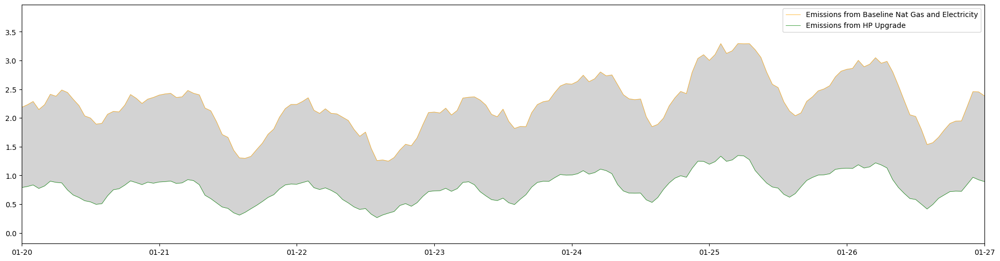

In [172]:
# plot emissions profiles for baseline and upgrade on the same axes
plt.figure(figsize=(24,6))
datemin = pd.Timestamp('2007-01-20')
datemax = pd.Timestamp('2007-01-27')
cambium_scenario = 'mid-case'

plt.plot(((cluster_baseline_natgas_hrly_mean * 0.18) + (cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000)), color='orange', linewidth=0.5, label = 'Emissions from Baseline Nat Gas and Electricity')
plt.plot((cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000), color='green', linewidth=0.5, label = 'Emissions from HP Upgrade')# limit x axis to datemin and datemax
plt.xlim(datemin, datemax)
# change the x ticks to not include the year
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))

# shade the area between the two lines
plt.fill_between(cluster_baseline_natgas_hrly_mean.index,
                    ((cluster_baseline_natgas_hrly_mean * 0.18) + (cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000)),
                    (cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000),
                    color='lightgray')
plt.savefig('test_mid-case_offset_jan20-27.svg', format='svg', dpi=1200)
plt.legend(fontsize=10)

In [143]:
# get timeseries of emissions difference between baseline and upgrade for each cambium scenario
cambium_scenarios = list(NE_LRME_df.columns)

In [144]:
cambium_scenarios

['mid-case', 'lowREcost', 'highREcost', '95decarb2035', 'electrification']

In [147]:
longrun_hrly_emissions_avoided = pd.DataFrame()

for scenario in cambium_scenarios:
    baseline_emissions = ((cluster_baseline_natgas_hrly_mean * 0.18) + (cluster_baseline_hvac_electricity_hrly_mean * NE_LRME_df[scenario].values/1000))
    upgrade_emissions = (cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[scenario].values/1000)
    longrun_hrly_emissions_avoided[scenario] = baseline_emissions - upgrade_emissions

In [148]:
longrun_hrly_emissions_avoided

,mid-case,lowREcost,highREcost,95decarb2035,electrification
timestamp,,,,,
2007-01-01 00:00:00,0.662997,0.700445,0.699913,0.771260,0.660246
2007-01-01 01:00:00,0.636209,0.665470,0.664963,0.722903,0.635268
2007-01-01 02:00:00,0.648966,0.677523,0.678086,0.733582,0.649388
2007-01-01 03:00:00,0.610733,0.635525,0.635460,0.688651,0.608503
2007-01-01 04:00:00,0.645316,0.670313,0.673051,0.728101,0.644052
...,...,...,...,...,...
2007-12-31 19:00:00,1.029874,1.076720,1.113103,1.349947,1.022741
2007-12-31 20:00:00,1.013531,1.070389,1.103862,1.326710,1.014448
2007-12-31 21:00:00,1.098994,1.155298,1.195370,1.442144,1.103813


In [150]:
longrun_hrly_emissions_avoided.sum() # total ANNUAL emissions avoided for each scenario, in kgCO2

mid-case           3978.582637
lowREcost          4196.374192
highREcost         4159.595498
95decarb2035       4640.568125
electrification    3983.767118
dtype: float64

In [152]:
longrun_hrly_emissions_avoided.sum() * 15 # total emissions avoided for each scenario over 15 YEARS, in kgCO2

mid-case           59678.739556
lowREcost          62945.612877
highREcost         62393.932476
95decarb2035       69608.521881
electrification    59756.506767
dtype: float64

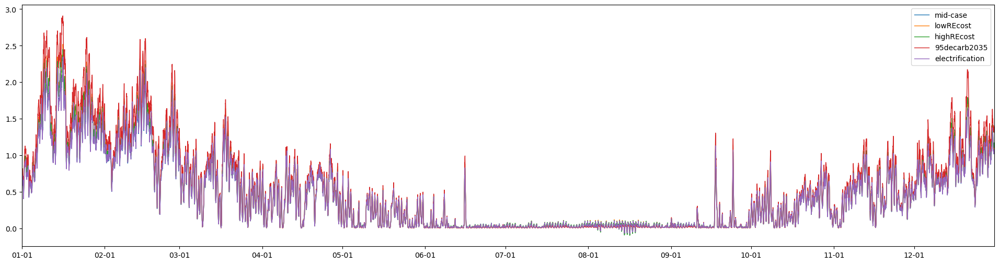

In [159]:
# plot longrun emissions avoided for each scenario
plt.subplots(figsize=(24,6))
datemin = pd.Timestamp('2007-01-01')
datemax = pd.Timestamp('2007-12-31')

for scenario in cambium_scenarios:
    plt.plot(longrun_hrly_emissions_avoided[scenario], linewidth=1, label=scenario)

plt.xlim(datemin, datemax)
# change the x ticks to not include the year
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))
plt.legend(fontsize=10)

plt.show()


In [ ]:
longrun_

<AxesSubplot: xlabel='timestamp'>

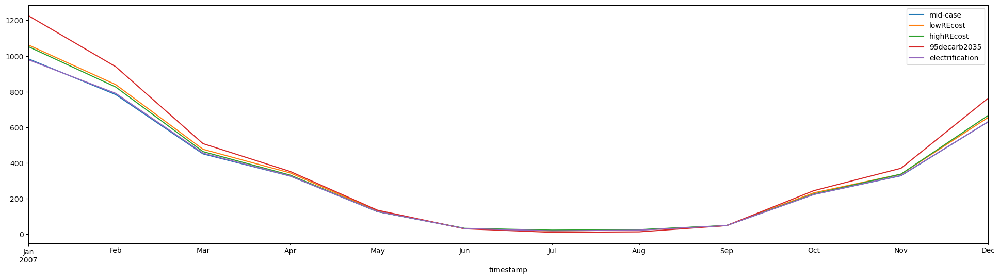

In [157]:
# resample the emissions avoided data to monthly
longrun_monthly_emissions_avoided = longrun_hrly_emissions_avoided.resample('M').sum()

longrun_monthly_emissions_avoided.plot(figsize=(24,6))

In [161]:
longrun_monthly_emissions_avoided

,mid-case,lowREcost,highREcost,95decarb2035,electrification
timestamp,,,,,
2007-01-31,983.710846,1061.830843,1052.373439,1225.890755,978.846726
2007-02-28,783.645242,839.406208,825.889754,939.790780,790.431708
2007-03-31,450.775471,476.550823,463.438880,508.371928,454.816577
2007-04-30,326.205145,343.674210,331.554518,351.859699,326.972926
2007-05-31,126.595338,130.057036,126.866140,134.728062,127.255039
2007-06-30,31.653645,30.954082,32.894328,30.346157,31.662028
2007-07-31,20.848492,17.913715,22.803949,10.507960,18.891517
2007-08-31,24.564736,23.539661,25.454581,13.246645,22.563906
2007-09-30,48.255358,48.000985,48.709598,48.108917,48.201989


In [162]:
longrun_monthly_emissions_avoided.sum() # total ANNUAL emissions avoided for each scenario, in kgCO2

mid-case           3978.582637
lowREcost          4196.374192
highREcost         4159.595498
95decarb2035       4640.568125
electrification    3983.767118
dtype: float64

In [163]:
# resample longrun emissions avoided data to quarterly
longrun_quarterly_emissions_avoided = longrun_hrly_emissions_avoided.resample('Q').sum()

In [164]:
longrun_quarterly_emissions_avoided

,mid-case,lowREcost,highREcost,95decarb2035,electrification
timestamp,,,,,
2007-03-31,2218.131559,2377.787874,2341.702073,2674.053463,2224.095011
2007-06-30,484.454127,504.685327,491.314986,516.933918,485.889993
2007-09-30,93.668586,89.454362,96.968128,71.863522,89.657412
2007-12-31,1182.328364,1224.446629,1229.610311,1377.717222,1184.124702


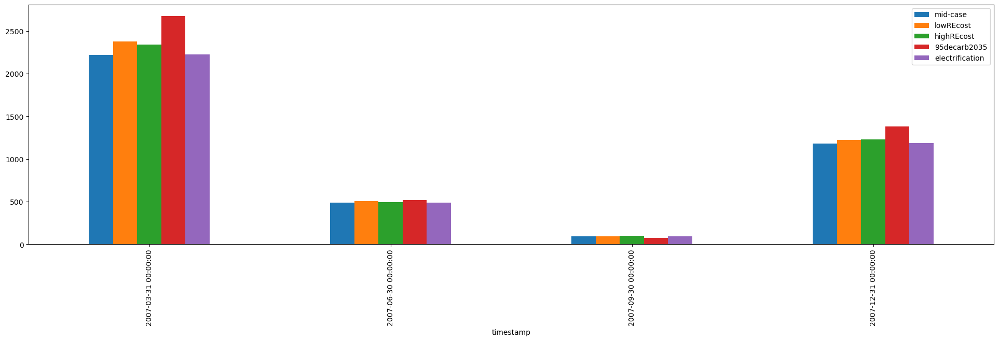

In [168]:
# plot longrun quarterly emissions avoided as a bar chart side by side
longrun_quarterly_emissions_avoided.plot.bar(figsize=(24,6))

plt.show()


In [171]:
# create the same bar chart with with plotly
fig = go.Figure()

for scenario in cambium_scenarios:

    fig.add_trace(go.Bar(x=longrun_monthly_emissions_avoided.index, y=longrun_monthly_emissions_avoided[scenario],
                    name=scenario))
    
fig.update_layout(title='Longrun Monthly Emissions Avoided for Each Cambium Scenario',
                    xaxis_title='Time',
                    yaxis_title='Emissions Avoided (kgCO2)',

                    font=dict(
                        family="Courier New, monospace",
                        size=10,
                        color="RebeccaPurple"
                    )
                )

fig.show()

In [169]:
# create the same bar chart with with plotly
fig = go.Figure()

for scenario in cambium_scenarios:

    fig.add_trace(go.Bar(x=longrun_quarterly_emissions_avoided.index, y=longrun_quarterly_emissions_avoided[scenario],
                    name=scenario))
    
fig.update_layout(title='Longrun Quarterly Emissions Avoided for Each Cambium Scenario',
                    xaxis_title='Time',
                    yaxis_title='Emissions Avoided (kgCO2)',

                    font=dict(
                        family="Courier New, monospace",
                        size=10,
                        color="RebeccaPurple"
                    )
                )

fig.show()

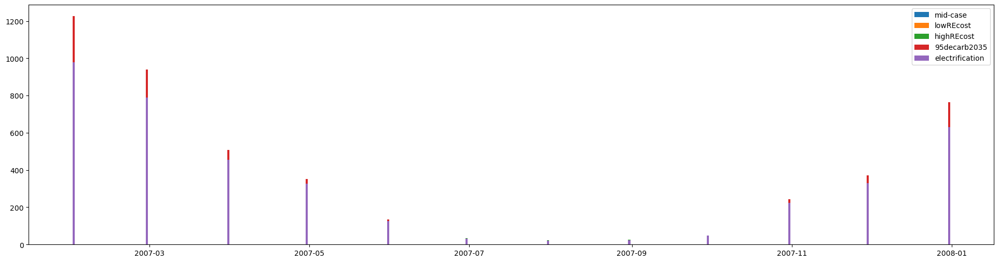

In [160]:
# plot longrun emissions avoided for each scenario as a bar chart for each month
plt.subplots(figsize=(24,6))

for scenario in cambium_scenarios:
    plt.bar(longrun_monthly_emissions_avoided.index, longrun_monthly_emissions_avoided[scenario], label=scenario)

plt.legend(fontsize=10)
plt.show()

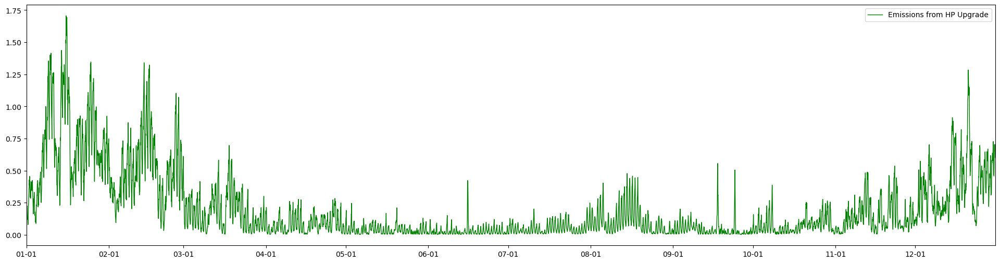

In [131]:
# plot emissions profiles for baseline and upgrade on the same axes
plt.figure(figsize=(24,6))
datemin = pd.Timestamp('2007-01-01')
datemax = pd.Timestamp('2007-12-31')
cambium_scenario = 'mid-case'

plt.plot((cluster_upgrade_hvac_electricity_hrly_mean * NE_LRME_df[cambium_scenario].values/1000), color='green', linewidth=1, label = 'Emissions from HP Upgrade')
# limit x axis to datemin and datemax
plt.xlim(datemin, datemax)
# change the x ticks to not include the year
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%m-%d'))

plt.legend(fontsize=10)